<a href="https://colab.research.google.com/github/marcelo0211/arquivos/blob/master/desafio_04.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install pandas-profiling==3.6.6
!pip install sidetable
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas_profiling


In [4]:
df = pd.read_csv('/content/data.csv', encoding='ISO-8859-1')
pd.set_option('display.max_rows',None)

In [5]:
df.head(5)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom


In [6]:
df=df.rename(columns={'CustomerID': 'Cod_cliente','Description':'Descr_Produto','InvoiceNo':'Cod_fatura','StockCode':'Cod_Estoque','Quantity':'Qt','InvoiceDate':'Dt_Faturamento','UnitPrice':'Preco_unit','Country':'Pais' })

CustomerID ->  Código de identificação do cliente
Description -> Descrição do produto
InvoiceNo ->   Código da fatura
StockCode ->  Código de estoque do produto
Quantity  ->   Quantidade do produto
InvoiceDate->  Data do faturamento (compra)
UnitPrice ->   Preço unitário do produto


In [7]:
df.head(5)

,Cod_fatura,Cod_Estoque,Descr_Produto,Qt,Dt_Faturamento,Preco_unit,Cod_cliente,Pais
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Cod_fatura      541909 non-null  object 
 1   Cod_Estoque     541909 non-null  object 
 2   Descr_Produto   540455 non-null  object 
 3   Qt              541909 non-null  int64  
 4   Dt_Faturamento  541909 non-null  object 
 5   Preco_unit      541909 non-null  float64
 6   Cod_cliente     406829 non-null  float64
 7   Pais            541909 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 33.1+ MB


**Ajustando os tipos de dados e o formato da "Data do faturamento".**


In [9]:
from datetime import date
# Convertendo a coluna "dt_faturamento" para o tipo de dado datetime
df['Dt_Faturamento'] = pd.to_datetime(df['Dt_Faturamento'])
#df['Dt_Faturamento'] = pd.to_datetime(df['Dt_Faturamento'], format='%m/%d/%Y %H:%M')
# Removendo as horas, minutos e segundos da coluna "data_completa"
df['Dt_Faturamento'] = df['Dt_Faturamento'].dt.date



**Ajustando os tipos de dados das colunas "Cod_fatura","Cod_Estoque" e Descr_Produto para str.**

In [10]:
df['Cod_fatura'] = df['Cod_fatura'].astype(str)
df['Cod_Estoque'] = df['Cod_Estoque'].astype(str)
df['Descr_Produto'] = df['Descr_Produto'].astype(str)


**Eliminando caracteres estranhos na coluna "Cod_fatura" e Cod_Estoque.**

In [11]:
df['Cod_fatura'] = df['Cod_fatura'].str.replace('C', '')
df['Cod_fatura'] = df['Cod_fatura'].str.replace('A', '')
df['Descr_Produto'] = df['Descr_Produto'].str.replace('*','')

df['Cod_Estoque'] = df['Cod_Estoque'].str.replace(r'[^\d]', '', regex=True)


<ipython-input-11-da514295d029>:3: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df['Descr_Produto'] = df['Descr_Produto'].str.replace('*','')


######################################

**Eliminando linhas com valores vazio 'Descr_Produto' e 'Cod_cliente', linhas que contêm "?" na coluna 'Descr_Produto'.**

In [19]:
# Eliminando as linhas com valores vazios na coluna "Descr_Produto" no próprio DataFrame
df.dropna(subset=['Descr_Produto'], inplace=True)

In [20]:
#Eliminar as linhas com codigo de clientes com valores vazios
df.dropna(subset=['Cod_cliente'], inplace=True)

In [21]:
# Deletando todas as linhas que contêm "?" na coluna 'Descr_Produto'
#df = df[df['Descr_Produto'] != '?']f = df[~df['Descr_Produto'].str.contains('\?')]


**Alterar o tipo de dado da coluna "Cod_cliente" de float para inteiro**


In [22]:
df['Cod_cliente'] = df['Cod_cliente'].astype(int)

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 406829 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Cod_fatura      406829 non-null  object 
 1   Cod_Estoque     406829 non-null  object 
 2   Descr_Produto   406829 non-null  object 
 3   Qt              406829 non-null  int64  
 4   Dt_Faturamento  406829 non-null  object 
 5   Preco_unit      406829 non-null  float64
 6   Cod_cliente     406829 non-null  int64  
 7   Pais            406829 non-null  object 
dtypes: float64(1), int64(2), object(5)
memory usage: 27.9+ MB


**Filtrando valores vazio na coluna 'Cod_Estoque'.**

In [24]:
# Filtrando os registros onde 'descricao_do_produto' é Diferente de vazio e 'codigo' está vazio
registros_vazios = df[(df['Descr_Produto'] !='') & (df['Cod_Estoque'] == '')]
registros_vazios.head()

,Cod_fatura,Cod_Estoque,Descr_Produto,Qt,Dt_Faturamento,Preco_unit,Cod_cliente,Pais
45,536370,,POSTAGE,3,2010-12-01,18.00,12583,France
141,536379,,Discount,-1,2010-12-01,27.50,14527,United Kingdom
386,536403,,POSTAGE,1,2010-12-01,15.00,12791,Netherlands
1123,536527,,POSTAGE,1,2010-12-01,18.00,12662,Germany
2239,536569,,Manual,1,2010-12-01,1.25,16274,United Kingdom


**Eliminando linhas com quantidade negativa**

In [ ]:
df['Qt']<=0

In [26]:
df = df[df['Qt'] >=0]

**Atribuindo Valores a celulas vazias da coluna "Cod_Estoque".**

In [28]:
# Identificando as linhas onde a coluna "A" é igual a vazio ("")
linhas_vazias = df['Cod_Estoque'] == ''

# Atribuindo códigos correspondentes na coluna "B" para os valores vazios na coluna "A"
contador = 1
for indice in df[linhas_vazias].index:
    df.at[indice, 'Cod_Estoque'] = f'123{contador}'
    contador += 1

# Visualizando o DataFrame após a atribuição dos códigos correspondentes
print("\nDataFrame após a atribuição dos códigos correspondentes:")
print(df)




DataFrame após a atribuição dos códigos correspondentes:


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [29]:
df.head()

,Cod_fatura,Cod_Estoque,Descr_Produto,Qt,Dt_Faturamento,Preco_unit,Cod_cliente,Pais
0,536365,85123,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01,2.55,17850,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01,3.39,17850,United Kingdom
2,536365,84406,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01,2.75,17850,United Kingdom
3,536365,84029,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01,3.39,17850,United Kingdom
4,536365,84029,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01,3.39,17850,United Kingdom


**Eliminando as linhas da coluna "Preco_unit" com valor zero.**

In [30]:
df = df[df['Preco_unit'] != 0]

**Criando a coluna Valor_total = Qt x Preco_unit . **

In [31]:
df['Valor_total'] = df['Qt'] * df['Preco_unit']


In [32]:
df.head()

,Cod_fatura,Cod_Estoque,Descr_Produto,Qt,Dt_Faturamento,Preco_unit,Cod_cliente,Pais,Valor_total
0,536365,85123,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01,2.55,17850,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01,3.39,17850,United Kingdom,20.34
2,536365,84406,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01,2.75,17850,United Kingdom,22.00
3,536365,84029,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01,3.39,17850,United Kingdom,20.34
4,536365,84029,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01,3.39,17850,United Kingdom,20.34


**Salvando os dados tratados com formato de planilha eletronica(xlsx)**

In [33]:
nome_arquivo = 'dados_9.xlsx'
df.to_excel(nome_arquivo, index=False)

################**FIM DO AJUSTE DE DADOS**###################


**##############INICIANDO A ANALISE DOS DADOS##############**

In [34]:
df.duplicated().sum()

5222

In [35]:
df.describe()

,Qt,Preco_unit,Cod_cliente,Valor_total
count,397884.000000,397884.000000,397884.000000,397884.000000
mean,12.988238,3.116488,15294.423453,22.397000
std,179.331775,22.097877,1713.141560,309.071041
min,1.000000,0.001000,12346.000000,0.001000
25%,2.000000,1.250000,13969.000000,4.680000
50%,6.000000,1.950000,15159.000000,11.800000
75%,12.000000,3.750000,16795.000000,19.800000
max,80995.000000,8142.750000,18287.000000,168469.600000


In [124]:
df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Encontrando a ultima data de compra de cada cliente no dataset como um todo**

In [36]:
df.head(5)

,Cod_fatura,Cod_Estoque,Descr_Produto,Qt,Dt_Faturamento,Preco_unit,Cod_cliente,Pais,Valor_total
0,536365,85123,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01,2.55,17850,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01,3.39,17850,United Kingdom,20.34
2,536365,84406,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01,2.75,17850,United Kingdom,22.00
3,536365,84029,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01,3.39,17850,United Kingdom,20.34
4,536365,84029,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01,3.39,17850,United Kingdom,20.34


In [37]:
df['Dt_Faturamento'] = pd.to_datetime(df['Dt_Faturamento'])


In [38]:
# Encontrando o índice da última data de compra em cada grupo
indices_ultimas_compras = df.groupby("Cod_cliente")["Dt_Faturamento"].idxmax()

# Selecionando os dados da última compra com base nos índices encontrados
ultimas_compras = df.loc[indices_ultimas_compras]


In [39]:
ultimas_compras


,Cod_fatura,Cod_Estoque,Descr_Produto,Qt,Dt_Faturamento,Preco_unit,Cod_cliente,Pais,Valor_total
61619,541431,23166,MEDIUM CERAMIC TOP STORAGE JAR,74215,2011-01-18,1.04,12346,United Kingdom,77183.60
535004,581180,23497,CLASSIC CHROME BICYCLE BELL,12,2011-12-07,1.45,12347,Iceland,17.40
359058,568172,23077,DOUGHNUT LIP GLOSS,120,2011-09-25,1.25,12348,Finland,150.00
485502,577609,23112,PARISIENNE CURIO CABINET,2,2011-11-21,7.50,12349,Italy,15.00
80323,543037,21908,CHOCOLATE THIS WAY METAL SIGN,12,2011-02-02,2.10,12350,Norway,25.20
437215,574275,23096,PETIT TRAY CHIC,12,2011-11-03,1.65,12352,Norway,19.80
197371,553900,37449,CERAMIC CAKE STAND + HANGING CAKES,2,2011-05-19,9.95,12353,Bahrain,19.90
166267,550911,23201,JUMBO BAG ALPHABET,10,2011-04-21,2.08,12354,Spain,20.80
181140,552449,22693,GROW A FLYTRAP OR SUNFLOWER IN TIN,24,2011-05-09,1.25,12355,Bahrain,30.00
475494,576895,22423,REGENCY CAKESTAND 3 TIER,2,2011-11-17,12.75,12356,Portugal,25.50


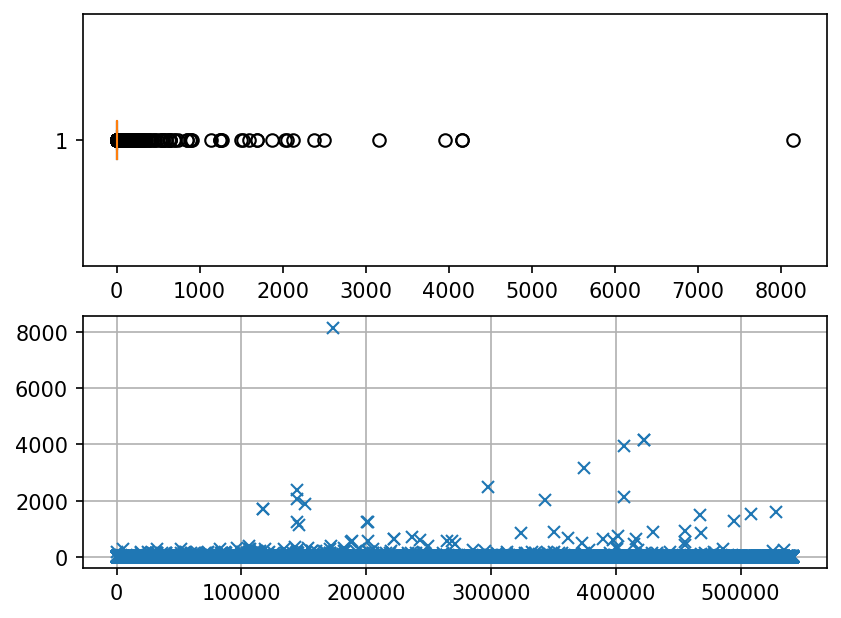

In [40]:
plt.figure(dpi=150)
plt.subplot(211)
plt.boxplot(df['Preco_unit'],vert=False)
plt.subplot(212)
plt.plot(df['Preco_unit'],'x')
plt.grid()
plt.show()

In [117]:
from scipy import stats

#############################################################


**Top 10 países com maior valor em vendas:**

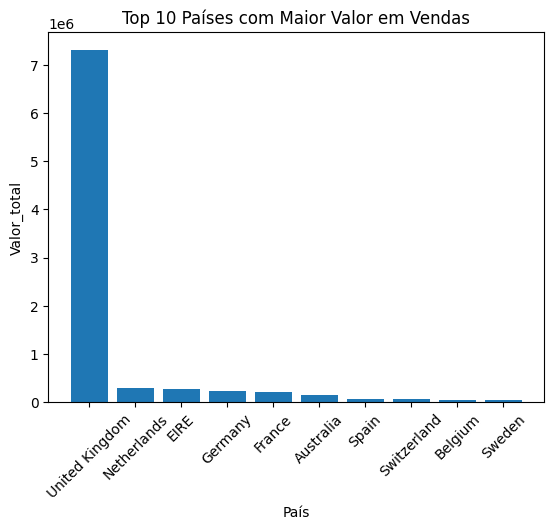

In [41]:
total_vendas_por_pais = df.groupby('Pais')['Valor_total'].sum()
top_10_paises = total_vendas_por_pais.nlargest(10)
# Criar o gráfico de barras
plt.bar(top_10_paises.index, top_10_paises.values)
plt.xlabel('País')
plt.ylabel('Valor_total')
plt.title('Top 10 Países com Maior Valor em Vendas')
plt.xticks(rotation=45)
plt.show()

**Top 10 produtos mais vendidos:**

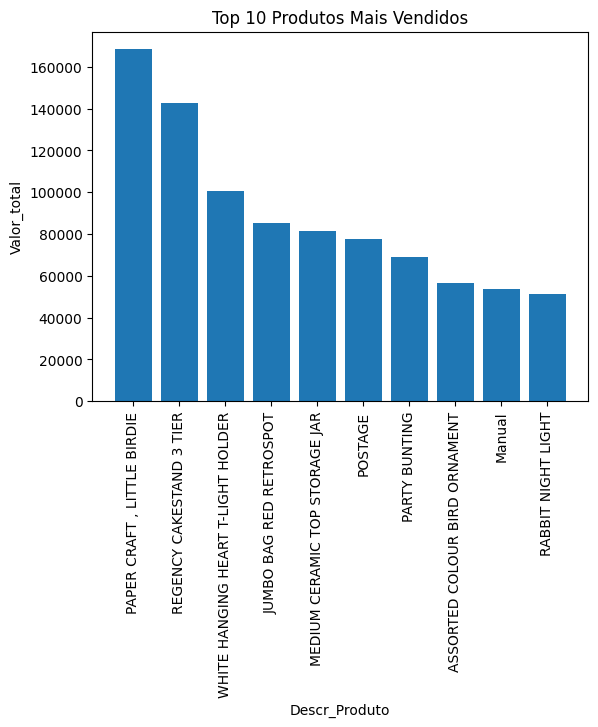

In [45]:
# Agrupar por produto e calcular o valor total de vendas
total_vendas_por_produto = df.groupby('Descr_Produto')['Valor_total'].sum()
# Ordenar em ordem decrescente e pegar os top 10
top_10_produtos = total_vendas_por_produto.nlargest(10)
# Criar o gráfico de barras
plt.bar(top_10_produtos.index, top_10_produtos.values)
plt.xlabel('Descr_Produto')
plt.ylabel('Valor_total')
plt.title('Top 10 Produtos Mais Vendidos')
plt.xticks(rotation=90)
plt.show()

**Valor de venda total por mês:**

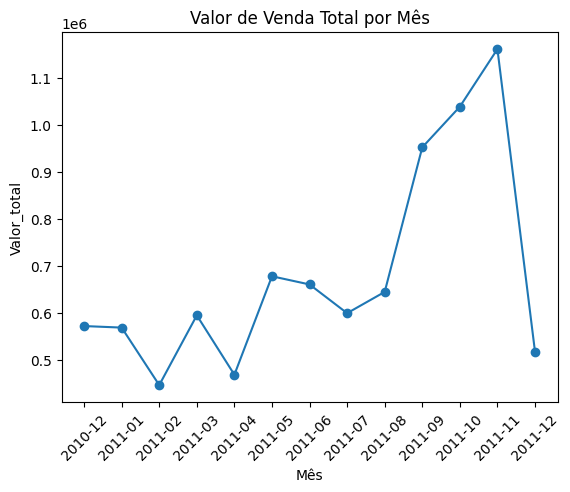

In [46]:
# Converter a coluna 'data' para o tipo datetime
df['Dt_Faturamento'] = pd.to_datetime(df['Dt_Faturamento'])
# Agrupar por mês e calcular o valor total de vendas
df['mes'] = df['Dt_Faturamento'].dt.strftime('%Y-%m')
total_vendas_por_mes = df.groupby('mes')['Valor_total'].sum()
# Criar o gráfico de linha
plt.plot(total_vendas_por_mes.index, total_vendas_por_mes.values, marker='o')
plt.xlabel('Mês')
plt.ylabel('Valor_total')
plt.title('Valor de Venda Total por Mês')
plt.xticks(rotation=45)
plt.show()




**Valor de venda total por mês e por país (top 10):**

<ipython-input-47-70ac13416331>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['mes'] = df_filtered['Dt_Faturamento'].dt.strftime('%Y-%m')


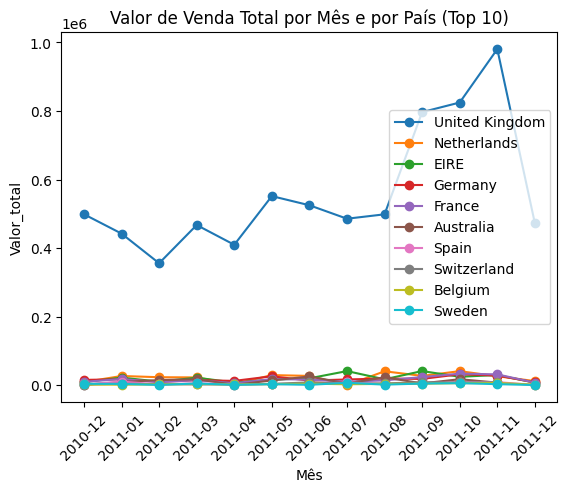

In [47]:
# Converter a coluna 'data' para o tipo datetime
df['Dt_Faturamento'] = pd.to_datetime(df['Dt_Faturamento'])

# Filtrar para considerar apenas os top 10 países
top_10_paises = df.groupby('Pais')['Valor_total'].sum().nlargest(10).index
df_filtered = df[df['Pais'].isin(top_10_paises)]

# Agrupar por mês e por país e calcular o valor total de vendas
df_filtered['mes'] = df_filtered['Dt_Faturamento'].dt.strftime('%Y-%m')
total_vendas_por_mes_pais = df_filtered.groupby(['mes', 'Pais'])['Valor_total'].sum()

# Criar o gráfico de linha (usando cores diferentes para cada país)
fig, ax = plt.subplots()
for pais in top_10_paises:
    dados_pais = total_vendas_por_mes_pais.loc[:, pais]
    ax.plot(dados_pais.index, dados_pais.values, marker='o', label=pais)
ax.set_xlabel('Mês')
ax.set_ylabel('Valor_total')
ax.set_title('Valor de Venda Total por Mês e por País (Top 10)')
ax.set_xticks(dados_pais.index)
ax.legend()
plt.xticks(rotation=45)
plt.show()

**Calculando a recencia de cada cliente**

In [ ]:
recencia_por_cliente = df.groupby('Cod_cliente')['Dt_Faturamento'].max().reset_index()
data_referencia = df['Dt_Faturamento'].max()
recencia_por_cliente['recencia'] = (data_referencia - recencia_por_cliente['Dt_Faturamento']).dt.days
#recencia_por_cliente.drop('Dt_Faturamento', axis=1, inplace=True)
print("\nRecência de cada cliente:")
print(recencia_por_cliente)



In [ ]:
ax.plot(recencia_por_cliente['Cod_cliente'], recencia_por_cliente['recencia'], marker='o', label='Clientes')
ax.set_xlabel('Clientes')
ax.set_ylabel('Ressencia')
ax.set_title('Recencia por Cliente')
ax.set_xticks(recencia_por_cliente['Cod_cliente'])
ax.legend()
plt.xticks(rotation=45)
plt.show()

In [ ]:
df.head()

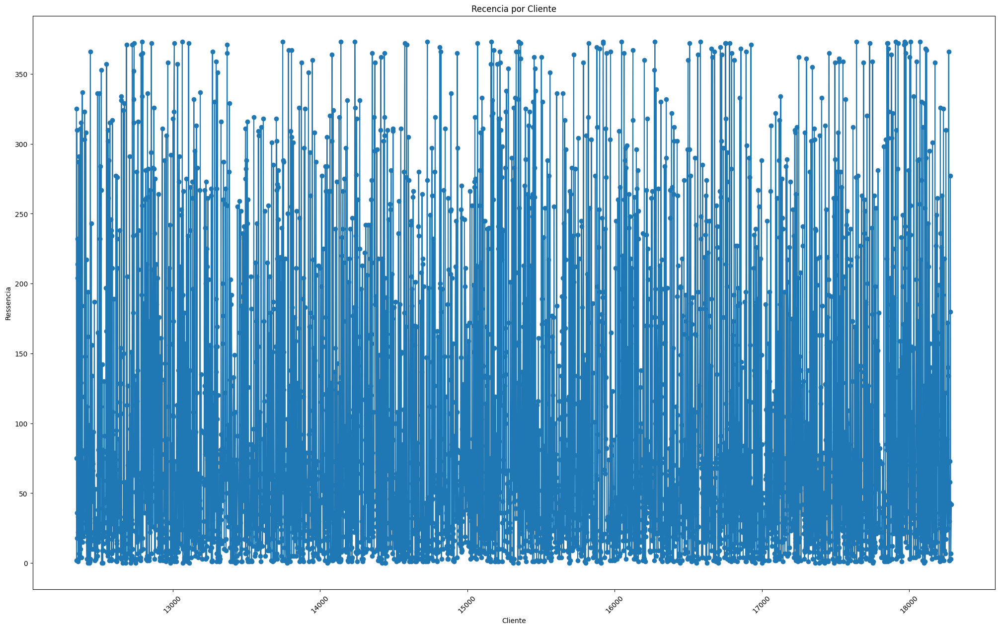

In [86]:
# Aumentando o tamanho do gráfico
plt.figure(figsize=(25, 15))

plt.plot(recencia_por_cliente['Cod_cliente'], recencia_por_cliente['recencia'], marker='o')
plt.xlabel('Cliente')
plt.ylabel('Ressencia')
plt.title('Recencia por Cliente')
plt.xticks(rotation=45)
plt.show()

**Frequencia :  A quantidade de compras feitas pelo cliente**

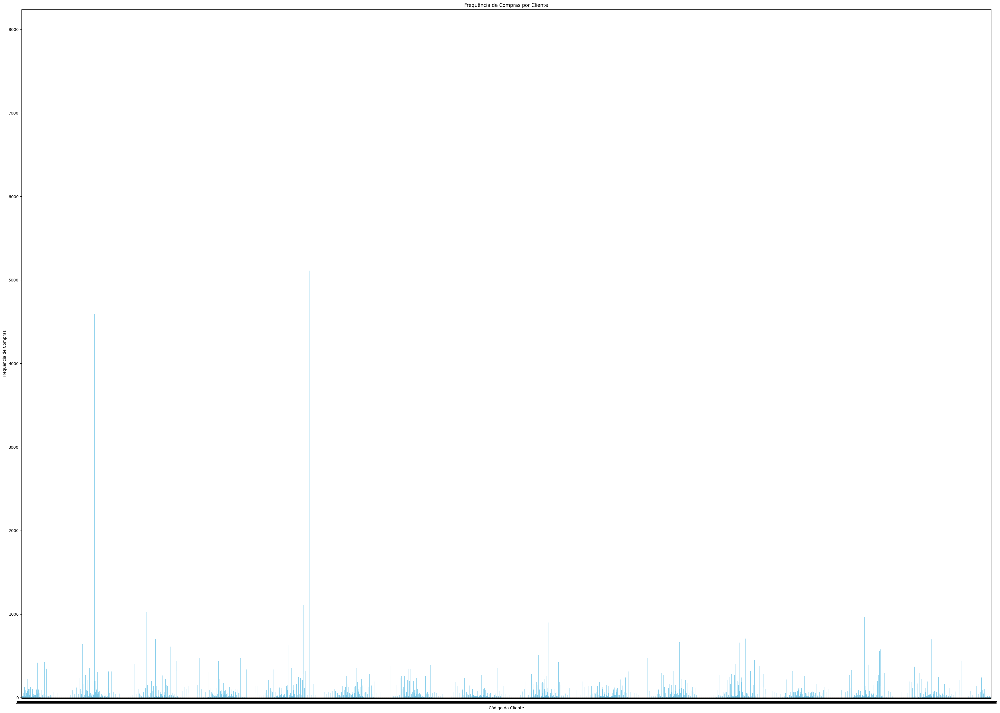

In [93]:
# Agrupando e contando as compras por cliente
frequencia_compras = df.groupby('Cod_cliente').size()
# Plotando o gráfico de frequência de compras
plt.figure(figsize=(35, 25))
frequencia_compras.plot(kind="bar", color="skyblue")
plt.xlabel("Código do Cliente")
plt.ylabel("Frequência de Compras")
plt.title("Frequência de Compras por Cliente")
plt.xticks(rotation=0)
plt.tight_layout()

# Exibindo o gráfico
plt.show()

In [ ]:
frequencia_compras.head



**Top 10 clientes com maior frequencia **

In [1]:
total_frequencia = df.groupby('Cod_cliente')['Valor_total'].sum()
top_10_clientes_freq = total_frequencia.nlargest(10)
# Criar o gráfico de barras
plt.bar(top_10_clientes_freq.index, top_10_clientes_freq.values)
plt.xlabel('Cod_cliente')
plt.ylabel('Valor_total')
plt.title('Top 10 clientes com maior frequencia em Vendas')
plt.xticks(rotation=90)
plt.show()



NameError: ignored